In [2]:
import pandas as pd
import numpy as np
import os
from data_revised_prep import *

import sys
import cv2

import shutil
import pydicom

from icecream import ic

import pydicom
import matplotlib.pyplot as plt

import pickle

In [3]:
def generate_pixels(sorted_paths):
    pixel = []
    for j in range(0, len(sorted_paths)):
        j_pixel = []  # Create an empty list for each j iteration
        for i in range(64, 129):
            ds = pydicom.dcmread(sorted_paths[j][i])
            pixel_arr = ds.pixel_array
            j_pixel.append(pixel_arr)  # Append each pixel array to j_pixel
        pixel.append(j_pixel)
    return pixel

# Steps to organize the ADNI dataset: 

1) Open a folder named "data-ADNI3-revised", 

2) inside "data-ADNI-revised" folder, add a subfolder named "raw" , also subfolder named "interim". 

3) As a subfolder of raw, create "ADNI3". As a subfolder of interim, create "ADNI3".

3) into the "raw" folder, add the unzipped data folders which are named as "3_ASMP_Sagittal_AD", "3_ASMP_Sagittal_CN","3_ASMP_Sagittal_MCI".


Notes: 
I changed the folders inside ASMIP_Sagittal_CN. -- the image ID's are not recorded properly.
I removed the folder "032_S_6602" from 3_ASMP_Sagittal_AD, ADNI 3 subfolder. It was a duplicate of some other folder in subfolder ADNI 2. 

# AD subjects

In [4]:
df_AD = pd.read_csv("../../data/data-ADNI/metadata/3_ASMP_Sagittal_AD_4_01_2024.csv")
new_df_AD= remove_duplicates(df_AD)

data_folder_AD = "../../data/data-ADNI/raw/3_ASMP_Sagittal_AD"  
data_paths_AD = get_new_filtered_data_paths(data_folder_AD, new_df_AD["Image Data ID"].tolist())

print('The number of AD subjects is '+str(len(new_df_AD)))
print('The number of total AD image paths is '+str(len(data_paths_AD)))

The number of AD subjects is 52
The number of total AD image paths is 52


In [5]:
# only_dcm_AD = [x for x in data_paths_AD if x.endswith(".dcm")]
sorted_paths_AD = list()
for i in range(0,len(data_paths_AD)):
        sorted_paths_AD.append(sorted(data_paths_AD[i], key = (lambda path: get_instance_number(path))))

In [6]:
len(sorted_paths_AD)

52

# MCI subjects

In [11]:
df_MCI = pd.read_csv("../../data/data-ADNI/metadata/3_ASMP_Sagittal_MCI_4_01_2024.csv")
new_df_MCI= remove_duplicates(df_MCI)

data_folder_MCI = "../../data/data-ADNI/raw/3_ASMP_Sagittal_MCI"  
data_paths_MCI = get_new_filtered_data_paths(data_folder_MCI, new_df_MCI["Image Data ID"].tolist())

## Sort images for each subject
sorted_paths_MCI = []
for i in range(0,len(data_paths_MCI)):
        sorted_paths_MCI.append(sorted(data_paths_MCI[i],key = lambda path: get_instance_number(path)))


MCI_dataset =  new_df_MCI.copy(deep=True)
MCI_dataset['Group'] = 'MCI'
MCI_dataset['image_paths'] = sorted_paths_MCI

## Remove the subject with id = 067_S_7029
MCI_dataset = MCI_dataset[~(MCI_dataset["Subject"]== "067_S_7029")]

MCI_dataset['pixels'] = generate_pixels(MCI_dataset['image_paths'].tolist())
# print('len(generate_pixels(sorted_paths_MCI))', len(generate_pixels(sorted_paths_MCI)))


print('The number of MCI subjects is '+str(len(MCI_dataset)))
print('The number of total image MCI paths is '+str(len(MCI_dataset['image_paths'].tolist())))

MCI_dataset.head()

The number of MCI subjects is 183
The number of total image MCI paths is 183


,Image Data ID,Subject,Group,Sex,Age,Visit,Modality,Description,Type,Acq Date,Format,Downloaded,image_paths,pixels
335,I843510,002_S_1155,MCI,M,68,init,MRI,Accelerated Sagittal MPRAGE,Original,2017-04-24,DCM,3/30/2024,[../../data/data-ADNI/raw/3_ASMP_Sagittal_MCI/...,"[[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0..."
238,I1118713,002_S_6652,MCI,F,86,sc,MRI,Accelerated Sagittal MPRAGE,Original,2018-12-13,DCM,3/30/2024,[../../data/data-ADNI/raw/3_ASMP_Sagittal_MCI/...,"[[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0..."
164,I1270149,002_S_6695,MCI,M,66,sc,MRI,Accelerated Sagittal MPRAGE,Original,2019-03-14,DCM,3/30/2024,[../../data/data-ADNI/raw/3_ASMP_Sagittal_MCI/...,"[[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0..."
150,I1303613,002_S_6864,MCI,F,69,sc,MRI,Accelerated Sagittal MPRAGE,Original,2020-03-11,DCM,3/30/2024,[../../data/data-ADNI/raw/3_ASMP_Sagittal_MCI/...,"[[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0..."
310,I969412,003_S_0908,MCI,F,74,init,MRI,Accelerated Sagittal MPRAGE,Original,2017-10-20,DCM,3/30/2024,[../../data/data-ADNI/raw/3_ASMP_Sagittal_MCI/...,"[[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0..."


In [12]:
rd = pydicom.dcmread("../../data/data-ADNI/raw/3_ASMP_Sagittal_MCI/067_S_7029/Accelerated_Sagittal_MPRAGE/2022-01-10_09_40_31.0/I1532649/ADNI_067_S_7029_MR_Accelerated_Sagittal_MPRAGE__br_raw_20220111113920663_1_S1095392_I1532649.dcm")

arr = rd.pixel_array
arr.mean(), arr.shape


(4.515364583333334, (256, 240))

# CN subjects

In [19]:

def get_new_filtered_data_paths_CN(data_folder, list_im_id):
    data_paths = []

    # Walk through the directory tree
    for root, dirs, files in os.walk(data_folder):
        for file in files:
            if file.endswith('.dcm'):  # Filter out files with .dcm extension
                full_path = os.path.join(root, file)
                data_paths.append(full_path)
    return data_paths


In [36]:
df_CN_1 = pd.read_csv("../../data/data-ADNI/metadata/Age50-_3_ASMP_Sagittal_CN_4_08_2024.csv")
df_CN_2 = pd.read_csv("../../data/data-ADNI/metadata/Age75-_3_ASMP_Sagittal_CN_4_08_2024.csv")

new_df_CN_1= remove_duplicates(df_CN_1)
remove_CN_1= ["I1327456","I1327480","I1340855"]
new_df_CN_1 = new_df_CN_1[~new_df_CN_1['Image Data ID'].isin(remove_CN_1)]

new_df_CN_2= remove_duplicates(df_CN_2)
new_df_CN_2 = new_df_CN_2[new_df_CN_2['Image Data ID'] != 'D10238706']

# combine the two CN datasets
combined_CN = pd.concat([new_df_CN_1, new_df_CN_2])
print('Combined CN shape: ', combined_CN.shape)

data_folder_CN = "../../data/data-ADNI/raw/3_ASMP_Sagittal_CN_combined"  


data_paths_CN = get_new_filtered_data_paths(data_folder_CN, combined_CN["Image Data ID"].tolist())

## Sort images for each subject
sorted_paths_CN = []
for i in range(0,len(data_paths_CN)):
        # ic(data_paths_CN[i])
        sorted_paths_CN.append(sorted(data_paths_CN[i],key = lambda path: get_instance_number(path)))

CN_dataset =  combined_CN.copy(deep=True)
CN_dataset['Group'] = 'CN'
CN_dataset['image_paths'] = sorted_paths_CN
CN_dataset = CN_dataset[CN_dataset['image_paths'].map(lambda d: len(d)) > 0]

print('The number of CN subjects is '+str(len(CN_dataset)))
print('The number of total image CN paths is '+str(len(CN_dataset['image_paths'].tolist())))

CN_dataset['pixels'] = generate_pixels(CN_dataset['image_paths'].tolist())
# filter out the rows with no image paths
print('shape of CN_dataset', CN_dataset.shape)
# CN_dataset.head()



Combined CN shape:  (407, 12)
The number of CN subjects is 378
The number of total image CN paths is 378
shape of CN_dataset (378, 14)


,Image Data ID,Subject,Group,Sex,Age,Visit,Modality,Description,Type,Acq Date,Format,Downloaded,image_paths,pixels
269,I840235,002_S_6009,CN,M,68,sc,MRI,Accelerated Sagittal MPRAGE,Original,2017-04-17,DCM,3/30/2024,[../../data/data-ADNI/raw/3_ASMP_Sagittal_CN_c...,"[[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0..."
263,I861965,002_S_6030,CN,F,65,sc,MRI,Accelerated Sagittal MPRAGE,Original,2017-06-15,DCM,3/30/2024,[../../data/data-ADNI/raw/3_ASMP_Sagittal_CN_c...,"[[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0..."
249,I878146,002_S_6053,CN,M,66,sc,MRI,Accelerated Sagittal MPRAGE,Original,2017-07-18,DCM,3/30/2024,[../../data/data-ADNI/raw/3_ASMP_Sagittal_CN_c...,"[[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0..."
232,I892212,002_S_6066,CN,F,68,sc,MRI,Accelerated Sagittal MPRAGE,Original,2017-08-16,DCM,3/30/2024,[../../data/data-ADNI/raw/3_ASMP_Sagittal_CN_c...,"[[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0..."
156,I938767,002_S_6103,CN,F,70,sc,MRI,Accelerated Sagittal MPRAGE,Original,2017-11-20,DCM,3/30/2024,[../../data/data-ADNI/raw/3_ASMP_Sagittal_CN_c...,"[[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0..."


In [40]:
len(set(df_CN_1['Subject'].unique()).union(df_CN_2['Subject'].unique()))

381

# Visualization


In [54]:

# Sort the list of paths based on instance numbers
sorted_dicom_paths = sorted(CN_dataset.loc[269, 'image_paths'], key=lambda path: get_instance_number(path))

# Example usage
#for dicom_path in sorted_dicom_paths:
    #print(dicom_path)

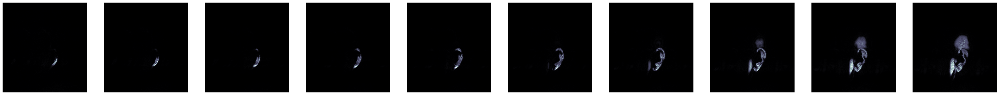

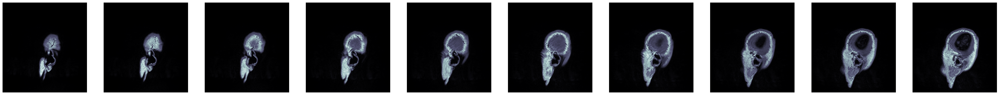

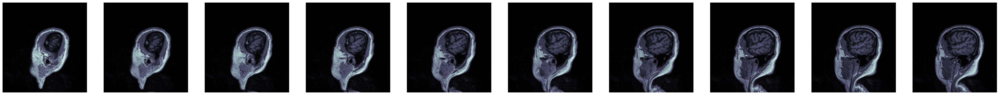

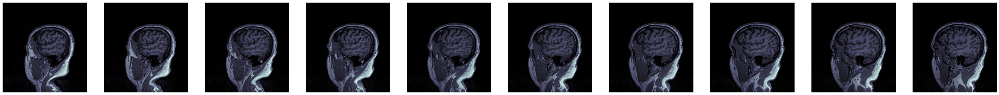

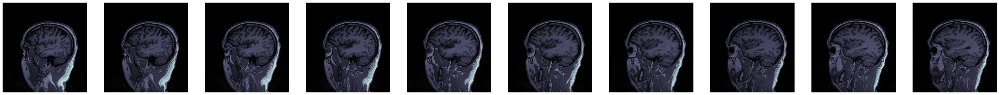

...

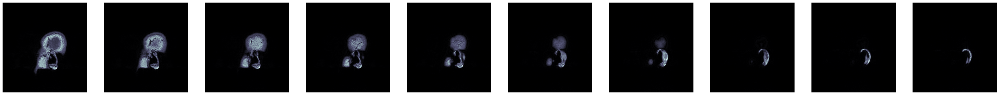

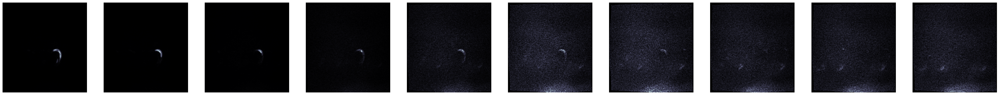

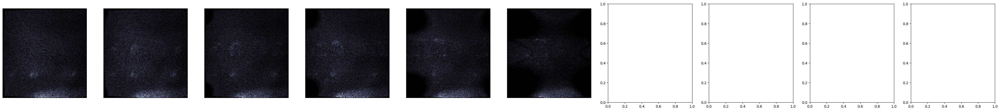

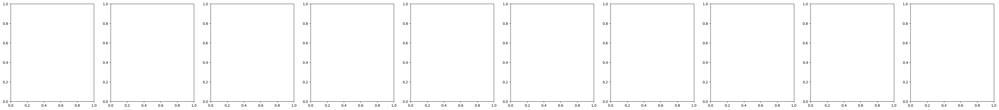

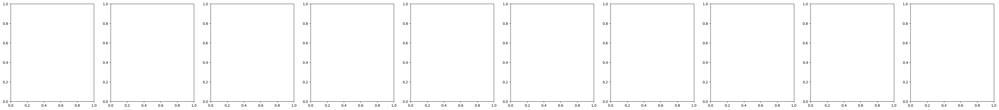

In [55]:
a=10
for j in range(1,20):
    plot_new_dicom_images(sorted_dicom_paths, num_images=10, i=a)
    a += 10

In [56]:
# convert the CN and MCI datasets to pickle files and save them
CN_dataset.to_pickle("../../data/data-ADNI/pkls/CN_dataset.pkl")
MCI_dataset.to_pickle("../../data/data-ADNI/pkls/MCI_dataset.pkl")

In [57]:
CN_dataset.columns

Index(['Image Data ID', 'Subject', 'Group', 'Sex', 'Age', 'Visit', 'Modality',
       'Description', 'Type', 'Acq Date', 'Format', 'Downloaded',
       'image_paths', 'pixels'],
      dtype='object')